In [1]:
import pandas
import xml.etree.ElementTree as ET
import os
import csv
import re
%matplotlib inline
import numpy as np
import pandas as pd
import librosa as lb
import librosa.display
import matplotlib.pyplot as plt
from gensim.models import Word2Vec
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from keras.layers import Input, Embedding, Dense, Flatten
from keras.layers import LSTM, Dropout
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from keras.models import Model

In [2]:
def read_csv(file_name):
    file = open(file_name)
    df = pandas.read_csv(file_name)
    return df

    

In [3]:
def read_bml(file_name):
    tree = ET.parse(file_name)
    root = tree.getroot()
    return root
    

In [4]:
def read_viseme(root):
    viseme_l = list()
    for child in root:
        viseme = list()
#         print(child.tag)
        if(child.tag == "lips"):
#             print(True)
            viseme.append(child.attrib['viseme'])
            viseme.append(child.attrib['start'])
            viseme.append(child.attrib['end'])
            viseme_l.append(viseme)
    return viseme_l
            

In [5]:
def read_transcript(root,end_time):
    for child in root:
        if(child.tag=='speech'):
            for child2 in child:
                if(child2.tag == 'text'):
                    texttag = child2
                    break
    transcript_l = list()
    next_t =0
    for i,sync in enumerate(texttag):
        transcript = list()
        for t in sync:
            print(t)
        if sync.text is None : 
            transcript.append('000')
        else:    
            transcript.append(sync.text)
#         transcript.append(prev)
        transcript.append(sync.attrib['time'])
        if(i<len(texttag)-1):
            transcript.append(texttag[i+1].attrib['time'])
        else:
            transcript.append(end_time)
        
        prev = sync.attrib['time']
        transcript_l.append(transcript)
        print(transcript_l)
    return transcript_l

In [6]:
def get_mfcc(filename,viseme_extract):
    mfcc_l = list()
    for rec in viseme_extract:
        try:
            mfcc = create_mfcc(filename,float(rec[1]),float(rec[2])).tolist()
            mfcc.append(rec[0])
            mfcc_l.append(mfcc)
        except:
            pass
    return mfcc_l

In [7]:
def create_mfcc(audio_path, start_ms, end_ms):
    start = start_ms/100
    end = end_ms/100
    data, sample_rate = lb.load(audio_path, offset = start, duration = end - start)
#     lb.display.waveplot(data)
#     print(type(data), type(sample_rate))
    mfcc = librosa.feature.mfcc(y=data, sr=sample_rate)
#     librosa.display.specshow(mfcc, sr=sample_rate, x_axis='time')
    mfccScaled = np.mean(mfcc.T, axis=0)
    return mfccScaled

## Modify files 

In [8]:
from google.colab import drive

drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [9]:
read_directory = 'gdrive/Shareddrives/CS535 Project/data/viseme'
write_directory = 'gdrive/Shareddrives/CS535 Project/data/viseme_modified_new'


## Run code below only to modify viseme files

In [10]:
for filename in os.listdir(read_directory):
    file_path_read = os.path.join(read_directory, filename)
    file_path_write = os.path.join(write_directory, filename)
    f_r = open(file_path_read,'r+')
    f_w = open(file_path_write,'w+')
    lines = f_r.readlines()
    for line in lines:
        if(re.match('.*sync.*',line)):
            line= line.replace('/','')
            line = line.replace('\n','')
            line = line + '</sync>\n'
            f_w.write(line)
        else:
            f_w.write(line)
    f_r.close()
    f_w.close()

## Read BML files

In [20]:
read_viseme_mod = 'gdrive/Shareddrives/CS535 Project/data/viseme_modified_new'
audio_dir = 'gdrive/Shareddrives/CS535 Project/data/raw_audio'
csv_file = 'gdrive/Shareddrives/CS535 Project/data/mfcc_feature_set.csv'

In [21]:
viseme_set = list()
transcript_set = list()
viseme_feature_set = list()

In [22]:
def feature_gneration(audio_gen):
    for filename in os.listdir(read_viseme_mod):
        file_path_read = os.path.join(read_viseme_mod, filename)
    #     print(file_path_read)
        f_r = open(file_path_read,'r+')
        root = read_bml(f_r)
        viseme_extract = read_viseme(root)
        f_split = filename.split("_")
        audio_session = f_split[0][4]
        if(len(f_split)==4):
            audio_file_dir = f_split[0]+"_"+f_split[1]+"_"+f_split[2]
        else:
            audio_file_dir = f_split[0]+"_"+f_split[1]
        audio_file_name = filename.split(".")[0]+".wav"
        audio_path = audio_dir + "/Session" + audio_session + "/sentences/wav/"+audio_file_dir+"/"+audio_file_name
    #     print(f_r)
        if(audio_gen):
            mfcc_= get_mfcc(audio_path,viseme_extract)
            with open(csv_file,'a') as f:
                csv_write = csv.writer(f)
                csv_write.writerows(mfcc_)
                csv_write.writerow(list('\n'))
            viseme_feature_set.append(mfcc_)
        viseme_set.append(viseme_extract)
    #     print(viseme_extract[len(viseme_extract)-1][2])
        transcript_set.append(read_transcript(root,viseme_extract[len(viseme_extract)-1][2]) )

In [14]:
feature_gneration(False)

Streaming output truncated to the last 5000 lines.
[['Absolutely', '0.22', '0.92'], ['000', '0.92', '0.92'], ['That', '0.92', '1.13'], ['000', '1.13', '1.13'], ['actually', '1.13', '1.46'], ['000', '1.46', '1.46'], ['goes', '1.46', '1.76'], ['000', '1.76', '1.76'], ['in', '1.76', '1.93'], ['000', '1.93', '1.93'], ['on', '1.93', '2.05'], ['000', '2.05', '2.05'], ['the', '2.05', '2.12'], ['000', '2.12', '2.12'], ['same', '2.12', '2.37'], ['000', '2.37', '2.37'], ['package', '2.37', '2.9'], ['000', '2.9', '2.9'], ['with', '2.9', '3.06'], ['000', '3.06', '3.13'], ['our', '3.13', '3.3'], ['000', '3.3', '3.3'], ['hotel', '3.3', '3.75'], ['000', '3.75', '3.75'], ['You', '3.75', '3.9'], ['000', '3.9', '3.9'], ['just', '3.9', '4.07'], ['000', '4.07', '4.07'], ['give', '4.07', '4.2'], ['000', '4.2', '4.2'], ['me', '4.2', '4.29'], ['000', '4.29', '4.29'], ['your', '4.29', '4.49'], ['000', '4.49', '4.49'], ['address', '4.49', '4.85'], ['000', '4.85', '4.85'], ["We'll", '4.85', '4.96'], ['000', '4.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[['Maybe', '2.02', '2.23']]
[['Maybe', '2.02', '2.23'], ['000', '2.23', '2.23']]
[['Maybe', '2.02', '2.23'], ['000', '2.23', '2.23'], ['if', '2.23', '2.39']]
[['Maybe', '2.02', '2.23'], ['000', '2.23', '2.23'], ['if', '2.23', '2.39'], ['000', '2.39', '2.39']]
[['Maybe', '2.02', '2.23'], ['000', '2.23', '2.23'], ['if', '2.23', '2.39'], ['000', '2.39', '2.39'], ['you', '2.39', '2.53']]
[['Maybe', '2.02', '2.23'], ['000', '2.23', '2.23'], ['if', '2.23', '2.39'], ['000', '2.39', '2.39'], ['you', '2.39', '2.53'], ['000', '2.53', '2.53']]
[['Maybe', '2.02', '2.23'], ['000', '2.23', '2.23'], ['if', '2.23', '2.39'], ['000', '2.39', '2.39'], ['you', '2.39', '2.53'], ['000', '2.53', '2.53'], ['were', '2.53', '2.6']]
[['Maybe', '2.02', '2.23'], ['000', '2.23', '2.23'], ['if', '2.23', '2.39'], ['000', '2.39', '2.39'], ['you', '2.39', '2.53'], ['000', '2.53', '2.53'], ['were', '2.53', '2.6'], ['000', '2.6', '2.6']]
[['Maybe', '2.02', '2.23'], ['000', '2.23', '2.23'], ['if', '2.23', '2.39'], ['000',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[["You're", '1.05', '1.38'], ['000', '1.38', '1.4'], ['kidding', '1.4', '1.91'], ['000', '1.91', '1.91'], ['me', '1.91', '2.05'], ['000', '2.05', '2.05'], ['this', '2.05', '2.25'], ['000', '2.25', '2.25'], ['is', '2.25', '2.53'], ['000', '2.53', '2.53'], ['a', '2.53', '2.64'], ['000', '2.64', '2.64']]
[["You're", '1.05', '1.38'], ['000', '1.38', '1.4'], ['kidding', '1.4', '1.91'], ['000', '1.91', '1.91'], ['me', '1.91', '2.05'], ['000', '2.05', '2.05'], ['this', '2.05', '2.25'], ['000', '2.25', '2.25'], ['is', '2.25', '2.53'], ['000', '2.53', '2.53'], ['a', '2.53', '2.64'], ['000', '2.64', '2.64'], ['joke', '2.64', '3.04']]
[["You're", '1.05', '1.38'], ['000', '1.38', '1.4'], ['kidding', '1.4', '1.91'], ['000', '1.91', '1.91'], ['me', '1.91', '2.05'], ['000', '2.05', '2.05'], ['this', '2.05', '2.25'], ['000', '2.25', '2.25'], ['is', '2.25', '2.53'], ['000', '2.53', '2.53'], ['a', '2.53', '2.64'], ['000', '2.64', '2.64'], ['joke', '2.64

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[['All', '0.33', '0.45'], ['000', '0.45', '0.45'], ['right', '0.45', '0.69'], ['000', '0.69', '0.69'], ['Miss', '0.69', '0.98'], ['000', '0.98', '0.99'], ['I', '0.99', '1.23'], ['000', '1.23', '1.41'], ['I', '1.41', '1.58'], ['000', '1.58', '1.58'], ['know', '1.58', '1.8'], ['000', '1.8', '1.81'], ['I', '1.81', '1.95'], ['000', '1.95', '1.95'], ['realize', '1.95', '2.34'], ['000', '2.34', '2.34'], ['this', '2.34', '2.57'], ['000', '2.57', '2.67'], ['But', '2.67', '2.95'], ['000', '2.95', '3.27'], ['Like', '3.27', '3.58'], ['000', '3.58', '4.09'], ['I', '4.09', '4.27'], ['000', '4.27', '4.27'], ['said', '4.27', '4.56'], ['000', '4.56', '4.56'], ['there', '4.56', '4.69'], ['000', '4.69', '4.69'], ['are', '4.69', '4.73'], ['000', '4.73', '4.73'], ['several', '4.73', '5.06'], ['000', '5.06', '5.06'], ['people', '5.06', '5.43'], ['000', '5.43', '5.43'], ['that', '5.43', '5.55'], ['000', '5.55', '5.55'], ['are', '5.55', '5.63'], ['000', '5.6

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[["You're", '0.16', '0.42'], ['000', '0.42', '0.45'], ['quite', '0.45', '0.84'], ['000', '0.84', '0.87'], ['insufferable', '0.87', '1.83']]
[["You're", '0.16', '0.42'], ['000', '0.42', '0.45'], ['quite', '0.45', '0.84'], ['000', '0.84', '0.87'], ['insufferable', '0.87', '1.83'], ['000', '1.83', '1.86']]
[['Oh', '0.5', '0.99']]
[['Oh', '0.5', '0.99'], ['000', '0.99', '0.99']]
[['Oh', '0.5', '0.99'], ['000', '0.99', '0.99'], ['Grow', '0.99', '1.56']]
[['Oh', '0.5', '0.99'], ['000', '0.99', '0.99'], ['Grow', '0.99', '1.56'], ['000', '1.56', '1.56']]
[['Oh', '0.5', '0.99'], ['000', '0.99', '0.99'], ['Grow', '0.99', '1.56'], ['000', '1.56', '1.56'], ['up', '1.56', '1.73']]
[['Oh', '0.5', '0.99'], ['000', '0.99', '0.99'], ['Grow', '0.99', '1.56'], ['000', '1.56', '1.56'], ['up', '1.56', '1.73'], ['000', '1.73', '2.55']]
[['Oh', '0.5', '0.99'], ['000', '0.99', '0.99'], ['Grow', '0.99', '1.56'], ['000', '1.56', '1.56'], ['up', '1.56', '1.73'],

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[['You', '1.08', '1.26'], ['000', '1.26', '1.26'], ['can', '1.26', '1.38'], ['000', '1.38', '1.38'], ['hardly', '1.38', '1.72'], ['000', '1.72', '1.72'], ['call', '1.72', '2.17'], ['000', '2.17', '2.25'], ['three', '2.25', '2.84'], ['000', '2.84', '2.84'], ['glasses', '2.84', '3.37'], ['000', '3.37', '3.37'], ['of', '3.37', '3.48'], ['000', '3.48', '3.48'], ['liquor', '3.48', '4'], ['000', '4', '4'], ['in', '4', '4.1'], ['000', '4.1', '4.1'], ['a', '4.1', '4.17'], ['000', '4.17', '4.17'], ['whole', '4.17', '4.46'], ['000', '4.46', '4.46'], ['evening', '4.46', '5.06'], ['000', '5.06', '5.45'], ['going', '5.45', '5.82'], ['000', '5.82', '5.82'], ['on', '5.82', '6.15']]
[['You', '1.08', '1.26'], ['000', '1.26', '1.26'], ['can', '1.26', '1.38'], ['000', '1.38', '1.38'], ['hardly', '1.38', '1.72'], ['000', '1.72', '1.72'], ['call', '1.72', '2.17'], ['000', '2.17', '2.25'], ['three', '2.25', '2.84'], ['000', '2.84', '2.84'], ['glasses', '2.8

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[['God', '0.43', '0.66'], ['000', '0.66', '0.66'], ["it's", '0.66', '0.92'], ['000', '0.92', '1.31'], ['you', '1.31', '1.49'], ['000', '1.49', '1.49'], ['know', '1.49', '1.55'], ['000', '1.55', '1.55'], ["we've", '1.55', '1.64'], ['000', '1.64', '1.64'], ['spent', '1.64', '1.84'], ['000', '1.84', '1.84'], ['so', '1.84', '1.94']]
[['God', '0.43', '0.66'], ['000', '0.66', '0.66'], ["it's", '0.66', '0.92'], ['000', '0.92', '1.31'], ['you', '1.31', '1.49'], ['000', '1.49', '1.49'], ['know', '1.49', '1.55'], ['000', '1.55', '1.55'], ["we've", '1.55', '1.64'], ['000', '1.64', '1.64'], ['spent', '1.64', '1.84'], ['000', '1.84', '1.84'], ['so', '1.84', '1.94'], ['000', '1.94', '1.94']]
[['God', '0.43', '0.66'], ['000', '0.66', '0.66'], ["it's", '0.66', '0.92'], ['000', '0.92', '1.31'], ['you', '1.31', '1.49'], ['000', '1.49', '1.49'], ['know', '1.49', '1.55'], ['000', '1.55', '1.55'], ["we've", '1.55', '1.64'], ['000', '1.64', '1.64'], ['spent', '1.64', '1.84'], ['000', '1.84', '1.84'], ['so',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[['I', '0.55', '0.69'], ['000', '0.69', '0.69'], ['knew', '0.69', '0.82'], ['000', '0.82', '0.82'], ['nothing', '0.82', '1.08'], ['000', '1.08', '1.08'], ['of', '1.08', '1.17'], ['000', '1.17', '1.17'], ['the', '1.17', '1.24'], ['000', '1.24', '1.24'], ['sort', '1.24', '1.67'], ['000', '1.67', '1.93'], ['You', '1.93', '2.09']]
[['I', '0.55', '0.69'], ['000', '0.69', '0.69'], ['knew', '0.69', '0.82'], ['000', '0.82', '0.82'], ['nothing', '0.82', '1.08'], ['000', '1.08', '1.08'], ['of', '1.08', '1.17'], ['000', '1.17', '1.17'], ['the', '1.17', '1.24'], ['000', '1.24', '1.24'], ['sort', '1.24', '1.67'], ['000', '1.67', '1.93'], ['You', '1.93', '2.09'], ['000', '2.09', '2.09']]
[['I', '0.55', '0.69'], ['000', '0.69', '0.69'], ['knew', '0.69', '0.82'], ['000', '0.82', '0.82'], ['nothing', '0.82', '1.08'], ['000', '1.08', '1.08'], ['of', '1.08', '1.17'], ['000', '1.17', '1.17'], ['the', '1.17', '1.24'], ['000', '1.24', '1.24'], ['sort', '1.2

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[['Well', '0', '0.46'], ['000', '0.46', '0.87'], ["we're", '0.87', '1.04'], ['000', '1.04', '1.04'], ['thinking', '1.04', '1.66'], ['000', '1.66', '1.66'], ['uh', '1.66', '2.23'], ['000', '2.23', '2.88'], ["we're", '2.88', '3.01'], ['000', '3.01', '3.01'], ['thinking', '3.01', '3.53'], ['000', '3.53', '3.56'], ['winter', '3.56', '3.86'], ['000', '3.86', '3.86'], ['time', '3.86', '4.13'], ['000', '4.13', '4.25'], ['you', '4.25', '4.39'], ['000', '4.39', '4.39'], ['know', '4.39', '4.49'], ['000', '4.49', '4.49'], ["we're", '4.49', '4.68'], ['000', '4.68', '4.68'], ['going', '4.68', '4.79'], ['000', '4.79', '4.79'], ['to', '4.79', '4.85'], ['000', '4.85', '4.85'], ['do', '4.85', '5.08']]
[['Well', '0', '0.46'], ['000', '0.46', '0.87'], ["we're", '0.87', '1.04'], ['000', '1.04', '1.04'], ['thinking', '1.04', '1.66'], ['000', '1.66', '1.66'], ['uh', '1.66', '2.23'], ['000', '2.23', '2.88'], ["we're", '2.88', '3.01'], ['000', '3.01', '3.01']

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[['Oh', '0.54', '0.74'], ['000', '0.74', '0.74'], ['whose', '0.74', '0.97']]
[['Oh', '0.54', '0.74'], ['000', '0.74', '0.74'], ['whose', '0.74', '0.97'], ['000', '0.97', '0.97']]
[['Oh', '0.54', '0.74'], ['000', '0.74', '0.74'], ['whose', '0.74', '0.97'], ['000', '0.97', '0.97'], ['they', '0.97', '1.46']]
[['Oh', '0.54', '0.74'], ['000', '0.74', '0.74'], ['whose', '0.74', '0.97'], ['000', '0.97', '0.97'], ['they', '0.97', '1.46'], ['000', '1.46', '2']]
[['Yeah', '0.34', '0.69']]
[['Yeah', '0.34', '0.69'], ['000', '0.69', '1.07']]
[['Yeah', '0.34', '0.69'], ['000', '0.69', '1.07'], ['In', '1.07', '1.21']]
[['Yeah', '0.34', '0.69'], ['000', '0.69', '1.07'], ['In', '1.07', '1.21'], ['000', '1.21', '1.21']]
[['Yeah', '0.34', '0.69'], ['000', '0.69', '1.07'], ['In', '1.07', '1.21'], ['000', '1.21', '1.21'], ['the', '1.21', '1.28']]
[['Yeah', '0.34', '0.69'], ['000', '0.69', '1.07'], ['In', '1.07', '1.21'], ['000', '1.21', '1.21'], ['the', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[['Snap', '0.28', '0.67']]
[['Snap', '0.28', '0.67'], ['000', '0.67', '0.67']]
[['Snap', '0.28', '0.67'], ['000', '0.67', '0.67'], ['snap', '0.67', '1.05']]
[['Snap', '0.28', '0.67'], ['000', '0.67', '0.67'], ['snap', '0.67', '1.05'], ['000', '1.05', '1.05']]
[['Snap', '0.28', '0.67'], ['000', '0.67', '0.67'], ['snap', '0.67', '1.05'], ['000', '1.05', '1.05'], ['snap', '1.05', '1.6']]
[['Snap', '0.28', '0.67'], ['000', '0.67', '0.67'], ['snap', '0.67', '1.05'], ['000', '1.05', '1.05'], ['snap', '1.05', '1.6'], ['000', '1.6', '1.6']]
[['Snap', '0.28', '0.67'], ['000', '0.67', '0.67'], ['snap', '0.67', '1.05'], ['000', '1.05', '1.05'], ['snap', '1.05', '1.6'], ['000', '1.6', '1.6'], ['like', '1.6', '1.74']]
[['Snap', '0.28', '0.67'], ['000', '0.67', '0.67'], ['snap', '0.67', '1.05'], ['000', '1.05', '1.05'], ['snap', '1.05', '1.6'], ['000', '1.6', '1.6'], ['like', '1.6', '1.74'], ['000', '1.74', '1.74']]
[['Snap', '0.28', '0.67'], ['000', '0.67', '0.67'], ['snap', '0.67', '1.05'], ['000'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[['Well', '0.78', '0.96'], ['000', '0.96', '0.96'], ['uh', '0.96', '1.32'], ['000', '1.32', '2.77'], ['He', '2.77', '2.88'], ['000', '2.88', '2.88']]
[['Well', '0.78', '0.96'], ['000', '0.96', '0.96'], ['uh', '0.96', '1.32'], ['000', '1.32', '2.77'], ['He', '2.77', '2.88'], ['000', '2.88', '2.88'], ['grew', '2.88', '3.24']]
[['Well', '0.78', '0.96'], ['000', '0.96', '0.96'], ['uh', '0.96', '1.32'], ['000', '1.32', '2.77'], ['He', '2.77', '2.88'], ['000', '2.88', '2.88'], ['grew', '2.88', '3.24'], ['000', '3.24', '3.36']]
[['Well', '0.78', '0.96'], ['000', '0.96', '0.96'], ['uh', '0.96', '1.32'], ['000', '1.32', '2.77'], ['He', '2.77', '2.88'], ['000', '2.88', '2.88'], ['grew', '2.88', '3.24'], ['000', '3.24', '3.36'], ['up', '3.36', '3.73']]
[['Well', '0.78', '0.96'], ['000', '0.96', '0.96'], ['uh', '0.96', '1.32'], ['000', '1.32', '2.77'], ['He', '2.77', '2.88'], ['000', '2.88', '2.88'], ['grew', '2.88', '3.24'], ['000', '3.24', '3.36

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[['Do', '0.29', '0.45'], ['000', '0.45', '0.45'], ['you', '0.45', '0.65']]
[['Do', '0.29', '0.45'], ['000', '0.45', '0.45'], ['you', '0.45', '0.65'], ['000', '0.65', '0.65']]
[['Do', '0.29', '0.45'], ['000', '0.45', '0.45'], ['you', '0.45', '0.65'], ['000', '0.65', '0.65'], ['are', '0.65', '0.81']]
[['Do', '0.29', '0.45'], ['000', '0.45', '0.45'], ['you', '0.45', '0.65'], ['000', '0.65', '0.65'], ['are', '0.65', '0.81'], ['000', '0.81', '0.81']]
[['Do', '0.29', '0.45'], ['000', '0.45', '0.45'], ['you', '0.45', '0.65'], ['000', '0.65', '0.65'], ['are', '0.65', '0.81'], ['000', '0.81', '0.81'], ['you', '0.81', '0.96']]
[['Do', '0.29', '0.45'], ['000', '0.45', '0.45'], ['you', '0.45', '0.65'], ['000', '0.65', '0.65'], ['are', '0.65', '0.81'], ['000', '0.81', '0.81'], ['you', '0.81', '0.96'], ['000', '0.96', '0.96']]
[['Do', '0.29', '0.45'], ['000', '0.45', '0.45'], ['you', '0.45', '0.65'], ['000', '0.65', '0.65'], ['are', '0.65', '0.81'],

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[['What', '0.47', '0.82'], ['000', '0.82', '0.82'], ['is', '0.82', '1'], ['000', '1', '1'], ['going', '1', '1.36'], ['000', '1.36', '1.36'], ['on', '1.36', '1.55'], ['000', '1.55', '1.59']]
[['What', '0.47', '0.82'], ['000', '0.82', '0.82'], ['is', '0.82', '1'], ['000', '1', '1'], ['going', '1', '1.36'], ['000', '1.36', '1.36'], ['on', '1.36', '1.55'], ['000', '1.55', '1.59'], ['here', '1.59', '1.85']]
[['What', '0.47', '0.82'], ['000', '0.82', '0.82'], ['is', '0.82', '1'], ['000', '1', '1'], ['going', '1', '1.36'], ['000', '1.36', '1.36'], ['on', '1.36', '1.55'], ['000', '1.55', '1.59'], ['here', '1.59', '1.85'], ['000', '1.85', '1.85']]
[['What', '0.47', '0.82'], ['000', '0.82', '0.82'], ['is', '0.82', '1'], ['000', '1', '1'], ['going', '1', '1.36'], ['000', '1.36', '1.36'], ['on', '1.36', '1.55'], ['000', '1.55', '1.59'], ['here', '1.59', '1.85'], ['000', '1.85', '1.85'], ['Joe', '1.85', '2.32']]
[['What', '0.47', '0.82'], ['000', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[['Going', '0.42', '0.81']]
[['Going', '0.42', '0.81'], ['000', '0.81', '0.87']]
[['Going', '0.42', '0.81'], ['000', '0.81', '0.87'], ['out', '0.87', '1.25']]
[['Going', '0.42', '0.81'], ['000', '0.81', '0.87'], ['out', '0.87', '1.25'], ['000', '1.25', '1.25']]
[['Going', '0.42', '0.81'], ['000', '0.81', '0.87'], ['out', '0.87', '1.25'], ['000', '1.25', '1.25'], ['somewhere', '1.25', '1.58']]
[['Going', '0.42', '0.81'], ['000', '0.81', '0.87'], ['out', '0.87', '1.25'], ['000', '1.25', '1.25'], ['somewhere', '1.25', '1.58'], ['000', '1.58', '1.58']]
[['Going', '0.42', '0.81'], ['000', '0.81', '0.87'], ['out', '0.87', '1.25'], ['000', '1.25', '1.25'], ['somewhere', '1.25', '1.58'], ['000', '1.58', '1.58'], ['dear', '1.58', '1.92']]
[['Going', '0.42', '0.81'], ['000', '0.81', '0.87'], ['out', '0.87', '1.25'], ['000', '1.25', '1.25'], ['somewhere', '1.25', '1.58'], ['000', '1.58', '1.58'], ['dear', '1.58', '1.92'], ['000', '1.92', '2.56']]
[['Yeah', '0.5', '0.76']]
[['Yeah', '0.5', '0.76']

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[["That's", '0.77', '0.91']]
[["That's", '0.77', '0.91'], ['000', '0.91', '0.91']]
[["That's", '0.77', '0.91'], ['000', '0.91', '0.91'], ['a', '0.91', '1.05']]
[["That's", '0.77', '0.91'], ['000', '0.91', '0.91'], ['a', '0.91', '1.05'], ['000', '1.05', '1.05']]
[["That's", '0.77', '0.91'], ['000', '0.91', '0.91'], ['a', '0.91', '1.05'], ['000', '1.05', '1.05'], ['good', '1.05', '1.11']]
[["That's", '0.77', '0.91'], ['000', '0.91', '0.91'], ['a', '0.91', '1.05'], ['000', '1.05', '1.05'], ['good', '1.05', '1.11'], ['000', '1.11', '1.11']]
[["That's", '0.77', '0.91'], ['000', '0.91', '0.91'], ['a', '0.91', '1.05'], ['000', '1.05', '1.05'], ['good', '1.05', '1.11'], ['000', '1.11', '1.11'], ['answer', '1.11', '1.49']]
[["That's", '0.77', '0.91'], ['000', '0.91', '0.91'], ['a', '0.91', '1.05'], ['000', '1.05', '1.05'], ['good', '1.05', '1.11'], ['000', '1.11', '1.11'], ['answer', '1.11', '1.49'], ['000', '1.49', '1.49']]
[["That's", '0.77', '0.91'], ['000', '0.91', '0.91'], ['a', '0.91', '1

In [15]:
len(viseme_set)

7260

In [16]:
len(transcript_set) 

7260

In [17]:
viseme_set

[[['_', '0', '0.4'],
  ['Ih', '0.4', '0.51'],
  ['D', '0.51', '0.6'],
  ['Er', '0.6', '0.7'],
  ['D', '0.7', '0.74'],
  ['D', '0.74', '0.75'],
  ['D', '0.75', '0.77'],
  ['W', '0.77', '0.8'],
  ['Sh', '0.8', '0.82'],
  ['W', '0.82', '1.08'],
  ['D', '1.08', '1.21'],
  ['W', '1.21', '1.23'],
  ['Ah', '1.23', '1.28'],
  ['Z', '1.28', '1.34'],
  ['L', '1.34', '1.43'],
  ['Ah', '1.43', '1.535'],
  ['Ih', '1.535', '1.64'],
  ['Kg', '1.64', '1.65'],
  ['_', '1.65', '2.09']],
 [['_', '0', '0.38'],
  ['Z', '0.38', '0.51'],
  ['Ow', '0.51', '0.56'],
  ['Sh', '0.56', '0.63'],
  ['W', '0.63', '0.7'],
  ['L', '0.7', '0.73'],
  ['Kg', '0.73', '0.8'],
  ['Ih', '0.8', '0.86'],
  ['F', '0.86', '0.88'],
  ['BMP', '0.88', '0.94'],
  ['Ih', '0.94', '1.01'],
  ['BMP', '1.01', '1.1'],
  ['Ah', '1.1', '1.2'],
  ['D', '1.2', '1.24'],
  ['Ih', '1.24', '1.3'],
  ['D', '1.3', '1.33'],
  ['Th', '1.33', '1.35'],
  ['Eh', '1.35', '1.43'],
  ['D', '1.43', '1.53'],
  ['Ay', '1.53', '1.57'],
  ['L', '1.57', '1.7'],
 

In [18]:
transcript_set

[[['He', '0.4', '0.51'],
  ['000', '0.51', '0.51'],
  ['turned', '0.51', '0.75'],
  ['000', '0.75', '0.75'],
  ['to', '0.75', '0.8'],
  ['000', '0.8', '0.8'],
  ['you', '0.8', '1.08'],
  ['000', '1.08', '1.08'],
  ['and', '1.08', '1.21'],
  ['000', '1.21', '1.21'],
  ['was', '1.21', '1.34'],
  ['000', '1.34', '1.34'],
  ['like', '1.34', '1.65'],
  ['000', '1.65', '2.09']],
 [['So', '0.38', '0.56'],
  ['000', '0.56', '0.56'],
  ["you'll", '0.56', '0.73'],
  ['000', '0.73', '0.73'],
  ['give', '0.73', '0.88'],
  ['000', '0.88', '0.88'],
  ['me', '0.88', '1.01'],
  ['000', '1.01', '1.01'],
  ['money', '1.01', '1.3'],
  ['000', '1.3', '1.3'],
  ['and', '1.3', '1.33'],
  ['000', '1.33', '1.33'],
  ['then', '1.33', '1.53'],
  ['000', '1.53', '1.53'],
  ["I'll", '1.53', '1.7'],
  ['000', '1.7', '1.7'],
  ['get', '1.7', '1.83'],
  ['000', '1.83', '1.83'],
  ['my', '1.83', '1.96'],
  ['000', '1.96', '1.96'],
  ['bag', '1.96', '2.3'],
  ['000', '2.3', '3.31']],
 [['I', '0.61', '0.8'],
  ['000', 

In [19]:
final_transcript = pd.DataFrame()
# print(transcript_set)
for i in range(len(transcript_set)):
  for j in range(len(transcript_set[i])):
    if (viseme_set[i][j][0] == 'Ah' or viseme_set[i][j][0] == 'Ih' or viseme_set[i][j][0] == 'Z' or viseme_set[i][j][0] == 'W' or viseme_set[i][j][0] == 'D') and (transcript_set[i][j][0] != '000'):
      final_transcript = final_transcript.append({'data':transcript_set[i][j][0], 'label':viseme_set[i][j][0]}, ignore_index=True)

In [23]:
final_transcript['label'].unique()

array(['D', 'Ah', 'W', 'Ih', 'Z'], dtype=object)

In [24]:
alphabet="abcdefghijklmnopqrstuvwxyz0123456789-,;.!?:'\"/\\|_@#$%^&*~`+-=<>()[]{}"

In [25]:
from sklearn import preprocessing  
object = preprocessing.LabelEncoder() 
final_transcript['label'] = object.fit_transform(final_transcript['label'])

In [26]:
final_transcript['label'].unique()

array([1, 0, 3, 2, 4])

In [27]:
final_transcript = final_transcript.rename(columns={'data': '1', 'label': '0'}, inplace=False)

In [28]:
final_transcript

,1,0
0,turned,1
1,to,1
2,you,1
3,was,1
4,like,0
...,...,...
43811,understand,0
43812,systems,2
43813,very,0
43814,difficult,1


In [29]:
X = final_transcript['1']

In [30]:
y = final_transcript['0']

In [31]:
y.unique()

array([1, 0, 3, 2, 4])

In [32]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [33]:
X_train_df = X_train.to_frame()
y_train_df = y_train.to_frame()

In [34]:
frames = [X_train_df, y_train_df]
train_df = pd.concat(frames, axis=1)

In [35]:
train_df

,1,0
41741,of,0
27102,you,4
29839,hear,1
14555,expect,1
36079,but,3
...,...,...
6265,I,1
11284,beach,1
38158,marry,0
860,like,1


In [36]:
X_test_df = X_test.to_frame()
y_test_df = y_test.to_frame()

In [37]:
frame = [X_test_df, y_test_df]
test_df = pd.concat(frame, axis=1)

In [38]:
test_df

,1,0
43510,very,0
19012,and,0
14084,entire,0
12231,going,4
35039,is,1
...,...,...
38107,going,2
1588,you,1
36929,is,4
18487,no,2


In [39]:
train_data_new = train_df['1']
test_data_new = test_df['1']

In [40]:
train_data_new = [s.lower() for s in train_data_new] 
test_data_new = [s.lower() for s in test_data_new] 


In [41]:
token = Tokenizer(num_words=None, char_level=True, oov_token='UNK')
token.fit_on_texts(train_data_new)

In [42]:
final_embeddings = []

In [43]:
dictionary = {}
for i, word in enumerate(alphabet):
    dictionary[word] = i+1


In [44]:
token.word_index = dictionary 
token.word_index[token.oov_token] = max(dictionary.values()) + 1

In [45]:
train_sequences = token.texts_to_sequences(train_data_new)
test_data_new_text = token.texts_to_sequences(test_data_new)


In [46]:
train_data = pad_sequences(train_sequences, maxlen=1014, padding='post')
test_data = pad_sequences(test_data_new_text, maxlen=1014, padding='post')


In [47]:
train_data = np.array(train_data)
test_data = np.array(test_data)

In [48]:
train_classes = train_df['0']
test_classes = test_df['0']

In [49]:
train_class_list = [x-1 for x in train_classes]
test_class_list = [x-1 for x in test_classes]


In [50]:
train_classes = to_categorical(train_class_list)
test_classes = to_categorical(test_class_list)

In [51]:
length_of_vocabulary = len(token.word_index)

In [52]:
final_embeddings.append(np.zeros(length_of_vocabulary))

In [53]:
for char, i in token.word_index.items(): 
    encodings = np.zeros(length_of_vocabulary)
    encodings[i-2] = 1
    final_embeddings.append(encodings)
final_embeddings = np.array(final_embeddings)

In [54]:
final_embeddings

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 1.],
       [1., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.]])

In [55]:
dropout_p = 0.5
optimizer = 'adam'
input_size = 1014
num_of_classes = 4
embedding_size = 69
loss = 'categorical_crossentropy'

In [56]:
embedding_layer = Embedding(length_of_vocabulary+1,
                            embedding_size,
                            weights=[final_embeddings],
                            input_length=input_size)

In [57]:
inputs = Input(shape=(input_size,))
embedded_sequence = embedding_layer(inputs)

In [58]:
layer = LSTM(128, return_sequences=True, activation='relu')(embedded_sequence)
layer = LSTM(256, return_sequences=True, activation='relu')(layer)
layer = Flatten()(layer)
layer = Dense(256, activation='relu')(layer)
layer = Dropout(dropout_p)(layer)
layer = Dense(128, activation='relu')(layer)
layer = Dropout(dropout_p)(layer)
final_prediction = Dense(num_of_classes, activation='softmax')(layer)

In [59]:
model = Model(inputs=inputs, outputs=final_prediction)
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 1014)]            0         
                                                                 
 embedding (Embedding)       (None, 1014, 69)          4830      
                                                                 
 lstm (LSTM)                 (None, 1014, 128)         101376    
                                                                 
 lstm_1 (LSTM)               (None, 1014, 256)         394240    
                                                                 
 flatten (Flatten)           (None, 259584)            0         
                                                                 
 dense (Dense)               (None, 256)               66453760  
                                                                 
 dropout (Dropout)           (None, 256)               0     

In [60]:
index = np.arange(train_data.shape[0])
np.random.shuffle(index)

In [61]:
x_train = train_data[index][:1000]
y_train = train_classes[index][:1000]
x_test = test_data[:500]
y_test = test_classes[:500]

In [62]:
# training
model.fit(x_train, y_train,
          validation_data=(x_test, y_test),
          batch_size=64,
          epochs=5,
          verbose=2)

Epoch 1/5
16/16 - 88s - loss: 1.3592 - accuracy: 0.3140 - val_loss: 1.3130 - val_accuracy: 0.3020 - 88s/epoch - 5s/step
Epoch 2/5
16/16 - 81s - loss: 1.3324 - accuracy: 0.3450 - val_loss: 1.3106 - val_accuracy: 0.3540 - 81s/epoch - 5s/step
Epoch 3/5
16/16 - 93s - loss: 1.3302 - accuracy: 0.3180 - val_loss: 1.3092 - val_accuracy: 0.3020 - 93s/epoch - 6s/step
Epoch 4/5
16/16 - 84s - loss: 1.3244 - accuracy: 0.3270 - val_loss: 1.3116 - val_accuracy: 0.3360 - 84s/epoch - 5s/step
Epoch 5/5
16/16 - 82s - loss: 1.3157 - accuracy: 0.3190 - val_loss: 1.3072 - val_accuracy: 0.3560 - 82s/epoch - 5s/step


In [63]:
prediction = model.predict(x_test, verbose=2)
print(prediction)
print(y_test)

16/16 - 6s - 6s/epoch - 371ms/step
[[0.31540215 0.23607703 0.1269849  0.32153592]
 [0.29877502 0.24288861 0.1524934  0.3058429 ]
 [0.32518584 0.23110478 0.11406471 0.32964462]
 ...
 [0.3020975  0.24159792 0.14676686 0.30953765]
 [0.30686525 0.23966426 0.13933489 0.3141356 ]
 [0.30995843 0.23847765 0.13429123 0.31727272]]
[[0. 0. 0. 1.]
 [0. 0. 0. 1.]
 [0. 0. 0. 1.]
 ...
 [0. 1. 0. 0.]
 [0. 1. 0. 0.]
 [1. 0. 0. 0.]]


In [64]:
print(classification_report(np.argmax(y_test, axis=1), np.argmax(prediction, axis=1)))

              precision    recall  f1-score   support

           0       0.47      0.05      0.08       151
           1       0.00      0.00      0.00       122
           2       0.00      0.00      0.00        50
           3       0.35      0.97      0.52       177

    accuracy                           0.36       500
   macro avg       0.20      0.25      0.15       500
weighted avg       0.27      0.36      0.21       500



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [66]:
from sklearn import metrics

#create confusion matrix
c_matrix = metrics.confusion_matrix(np.argmax(y_test, axis=1), np.argmax(prediction, axis=1))

#print confusion matrix
print(c_matrix)

[[  7   0   0 144]
 [  2   0   0 120]
 [  0   0   0  50]
 [  6   0   0 171]]


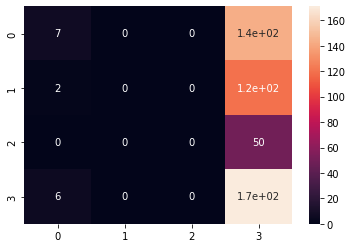

In [68]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

conf = metrics.confusion_matrix(np.argmax(y_test, axis=1), np.argmax(prediction, axis=1))
df = pd.DataFrame(conf, range(4), range(4))
sns.heatmap(df, annot=True)
plt.show()